In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import lasio
from scipy import signal
import seaborn as sns
import plotly.graph_objects as go
from plotly.subplots import make_subplots

In [2]:
import matplotlib.colors as mcolors
from matplotlib.patches import Rectangle

In [3]:
sns.set(style="whitegrid")

## creación del DF 

In [4]:
las= lasio.read('Sonic_P_and_S_Output_7240ft_350ft.las')
well = las.df()

In [5]:
well['Vs']=1/well['DTSM']
well['Vp']=1/well['DTCO']

In [6]:
well_clean = well.dropna(subset=['Vs', 'Vp', 'DTSM_FAST', 'DTST','VPVS','VPVS_FAST','RHOZ','DTSM','DTCO'])

depth = well_clean.index.values

## Promediado (smoothening)

In [7]:
#funcion smoothening
def moving_average(data, window_size):
    averaged_data = []
    for i in range(len(data)):
        if i < window_size - 1:
            averaged_data.append(np.nan)  # Si no hay suficientes datos para llenar la ventana, agregar NaN
        else:
            window = data[i - window_size + 1:i + 1]
            window_average = np.mean(window)
            averaged_data.append(window_average)
    return np.array(averaged_data)

### filtros

In [8]:
filt_l=75
filt_l2=50

In [9]:
Vs_smooth=moving_average(well_clean['Vs'].values,filt_l)
Vp_smooth=moving_average(well_clean['Vp'].values,filt_l)
Density_smooth=moving_average(well_clean['RHOZ'].values,filt_l)*1000
slowness_p_smooth=moving_average(well_clean['DTSM'].values,filt_l2)
slowness_s_smooth=moving_average(well_clean['DTCO'].values,filt_l2)

In [10]:
filt_sav=201 #wind savgol filter
pol=5 #pol savgol filter

In [11]:
Vs_smooth_sav=signal.savgol_filter(well_clean['Vs'].values, filt_sav, pol)
Vp_smooth_sav=signal.savgol_filter(well_clean['Vp'].values, filt_sav, pol)
Den_smooth_sav=signal.savgol_filter(well_clean['RHOZ'].values, filt_sav, pol)*1000
SloP_smooth_sav=signal.savgol_filter(well_clean['DTSM'].values,filt_sav,pol)
SloS_smooth_sav=signal.savgol_filter(well_clean['DTCO'].values,filt_sav,pol)

### graficos

In [12]:
fig = make_subplots(rows=3, cols=1, shared_yaxes=True, subplot_titles=("Density", "Vs", "Vp"))

fig.add_trace(go.Scatter(
    x=depth,  #ft
    y=well_clean['RHOZ'].values,
    marker=dict(
        size=2,
        color='purple',
        symbol='triangle-up'
    ),
    name='Density'
),row=1, col=1)

fig.add_trace(go.Scatter(
    x=depth, #ft
    y=well_clean['Vp'].values,
    marker=dict(
        size=2,
        color='hotpink',
        symbol='triangle-up'
    ),
    name='Vp'
),row=2, col=1)

fig.add_trace(go.Scatter(
    x=depth,  #ft
    y=well_clean['Vs'].values,
    marker=dict(
        size=2,
        color='orange',
        symbol='triangle-up'
    ),
    name='Vs'
),row=3, col=1)
fig.update_xaxes(title_text="Depth", row=3, col=1)

In [13]:
fig = make_subplots(rows=2, cols=1, shared_yaxes=True, subplot_titles=( "DTSM", "DTCO"))


fig.add_trace(go.Scatter(
    x=depth,  #ft
    y=well_clean['DTSM'].values,
    marker=dict(
        size=2,
        color='hotpink',
        symbol='triangle-up'
    ),
    name='Time S wave'
),row=1, col=1)

fig.add_trace(go.Scatter(
    x=depth,  #ft
    y=well_clean['DTCO'].values,
    marker=dict(
        size=2,
        color='purple',
        symbol='triangle-up'
    ),
    name='Time P wave'
),row=2, col=1)
fig.update_xaxes(title_text="Depth", row=2, col=1)

In [14]:
fig = make_subplots(rows=3, cols=1, shared_yaxes=True, subplot_titles=("Density", "Pwave slowness", "Swave slowness"))

fig.add_trace(go.Scatter(
    x=depth, #ft
    y=well_clean['RHOZ'].values,  
    marker=dict(
        size=2,
        color='blue',
        symbol='triangle-up'
    ),
    name='Before smoothening'
),row=1, col=1)
fig.add_trace(go.Scatter(
    x=depth, #ft
    y=Density_smooth, #g/cm^3
    marker=dict(
        size=2,
        color='hotpink',
        symbol='triangle-up'
    ),
    name='After smoothening'
),row=1, col=1)

# P wave
fig.add_trace(go.Scatter(
    x=depth, #ft
    y=well_clean['DTSM'].values, #slowness (miu s/ft) 
    marker=dict(
        size=2,
        color='blue',
        symbol='triangle-up'
    ),
    name='Before smoothening',
    showlegend=False
),row=2, col=1)
fig.add_trace(go.Scatter(
    x=depth,
    y=slowness_p_smooth,  
    marker=dict(
        size=2,
        color='hotpink',
        symbol='triangle-up'
    ),
    name='After smoothening',
    showlegend=False
),row=2, col=1)

# S wave
fig.add_trace(go.Scatter(
    x=depth,
    y=well_clean['DTCO'].values,  
    marker=dict(
        size=2,
        color='blue',
        symbol='triangle-up'
    ),
    name='After smoothening',
    showlegend=False
),row=3, col=1)
fig.add_trace(go.Scatter(
    x=depth,
    y=slowness_s_smooth, 
    marker=dict(
        size=2,
        color='hotpink',
        symbol='triangle-up'
    ),
    name='After smoothening',
    showlegend=False
),row=3, col=1)



# Ajustar el diseño
#fig.update_xaxes(range=[395, 5600], row=1, col=1)
#fig.update_xaxes(range=[395, 5600], row=2, col=1)
fig.update_xaxes(title_text="Depth", row=3, col=1)
# Mostrar la figura
fig.show()

In [15]:
fig = make_subplots(rows=3, cols=1, shared_yaxes=True, subplot_titles=("Density", "Swave slowness", "Pwave slowness"))

fig.add_trace(go.Scatter(
    x=depth,
    y=well_clean['RHOZ'].values,  #g/cm^3
    marker=dict(
        size=2,
        color='blue',
        symbol='triangle-up'
    ),
    name='Before smoothening'
),row=1, col=1)
fig.add_trace(go.Scatter(
    x=depth,
    y=Den_smooth_sav,   #g/cm^3
    marker=dict(
        size=2,
        color='hotpink',
        symbol='triangle-up'
    ),
    name='After smoothening'
),row=1, col=1)

# P wave
fig.add_trace(go.Scatter(
    x=depth,
    y=well_clean['DTSM'].values,  
    marker=dict(
        size=2,
        color='blue',
        symbol='triangle-up'
    ),
    name='Before smoothening',
    showlegend=False
),row=2, col=1)
fig.add_trace(go.Scatter(
    x=depth,
    y=SloP_smooth_sav,  
    marker=dict(
        size=2,
        color='hotpink',
        symbol='triangle-up'
    ),
    name='After smoothening',
    showlegend=False
),row=2, col=1)

# S wave
fig.add_trace(go.Scatter(
    x=depth,
    y=well_clean['DTCO'].values,  
    marker=dict(
        size=2,
        color='blue',
        symbol='triangle-up'
    ),
    name='After smoothening',
    showlegend=False
),row=3, col=1)
fig.add_trace(go.Scatter(
    x=depth,
    y=SloS_smooth_sav, 
    marker=dict(
        size=2,
        color='hotpink',
        symbol='triangle-up'
    ),
    name='After smoothening',
    showlegend=False
),row=3, col=1)



# Ajustar el diseño
#fig.update_xaxes(range=[395, 5600], row=1, col=1)
#fig.update_xaxes(range=[395, 5600], row=2, col=1)
fig.update_xaxes(title_text="Depth", row=3, col=1)
# Mostrar la figura
fig.show()

In [16]:
Vp_sl=1/SloP_smooth_sav
Vs_sl=1/SloS_smooth_sav

s_vel=1/well_clean['DTCO'].values
p_vel=1/well_clean['DTSM'].values

In [17]:
fig = make_subplots(rows=3, cols=1, shared_yaxes=True, subplot_titles=("Density", "Vp", "Vs"))

fig.add_trace(go.Scatter(
    x=depth,
    y=well_clean['RHOZ'].values*1000,  #kg/m^3
    marker=dict(
        size=2,
        color='blue',
        symbol='triangle-up'
    ),
    name='Before smoothening'
),row=1, col=1)
fig.add_trace(go.Scatter(
    x=depth,
    y=Density_smooth,  #kg/m^3
    marker=dict(
        size=2,
        color='hotpink',
        symbol='triangle-up'
    ),
    name='After smoothening'
),row=1, col=1)

# Añadir la primera subtrama (Vs)
fig.add_trace(go.Scatter(
    x=depth,
    y=s_vel,  #ft/miu s
    marker=dict(
        size=2,
        color='blue',
        symbol='triangle-up'
    ),
    name='Before smoothening',
    showlegend=False
),row=2, col=1)
fig.add_trace(go.Scatter(
    x=depth,
    y=Vs_sl,  #ft/miu s smooth
    marker=dict(
        size=2,
        color='hotpink',
        symbol='triangle-up'
    ),
    name='After smoothening',
    showlegend=False
),row=2, col=1)

# Añadir la segunda subtrama (Vp)
fig.add_trace(go.Scatter(
    x=depth,
    y=p_vel,  #ft/miu s
    marker=dict(
        size=2,
        color='blue',
        symbol='triangle-up'
    ),
    name='After smoothening',
    showlegend=False
),row=3, col=1)
fig.add_trace(go.Scatter(
    x=depth,
    y=Vp_sl,  #ft/miu s smooth
    marker=dict(
        size=2,
        color='hotpink',
        symbol='triangle-up'
    ),
    name='After smoothening',
    showlegend=False
),row=3, col=1)



# Ajustar el diseño
#fig.update_xaxes(range=[395, 5600], row=1, col=1)
#fig.update_xaxes(range=[395, 5600], row=2, col=1)
fig.update_xaxes(title_text="Depth", row=3, col=1)
# Mostrar la figura
fig.show()

<AxesSubplot:xlabel='DEPT'>

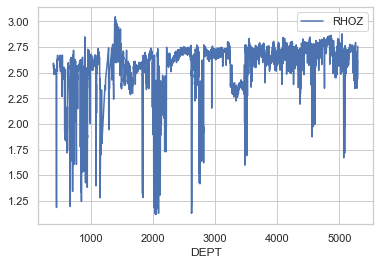

In [18]:
well_clean.plot(y='RHOZ')

## SI units

In [37]:
vs_ms=Vp_sl*0.3048*(10**6) #this is vs, i put the things backwards in naming so i just changed this part instead of changing all the code
vp_ms=Vs_sl*0.3048*(10**6) #this is vp, i put the things backwards in naming so i just changed this part

vs_org_ms= p_vel*0.3048*(10**6) #this is vs, i put the things backwards in naming so i just changed this part
vp_org_ms= s_vel*0.3048*(10**6) #this is vp, i put the things backwards in naming so i just changed this part

depth_m=depth*0.3048

In [38]:
fig = make_subplots(rows=3, cols=1, shared_yaxes=True, subplot_titles=("Vs", "Vp", "density"))

# Añadir la primera subtrama (Vs)
fig.add_trace(go.Scatter(
    x=depth_m,
    y=vs_org_ms,  # Ventana de tamaño 53 y polinomio de orden 3
    marker=dict(
        size=2,
        color='blue',
        symbol='triangle-up'
    ),
    name='Before smoothening',
    showlegend=True
),row=1, col=1)
fig.add_trace(go.Scatter(
    x=depth_m,
    y=vs_ms,  # Ventana de tamaño 53 y polinomio de orden 3
    marker=dict(
        size=2,
        color='hotpink',
        symbol='triangle-up'
    ),
    name='After smoothening',
    showlegend=True
),row=1, col=1)

# Añadir la segunda subtrama (Vp)
fig.add_trace(go.Scatter(
    x=depth_m,
    y=vp_org_ms,  # Ventana de tamaño 53 y polinomio de orden 3
    marker=dict(
        size=2,
        color='blue',
        symbol='triangle-up'
    ),
    name='After smoothening',
    showlegend=False
),row=2, col=1)
fig.add_trace(go.Scatter(
    x=depth_m,
    y=vp_ms,  # Ventana de tamaño 53 y polinomio de orden 3
    marker=dict(
        size=2,
        color='hotpink',
        symbol='triangle-up'
    ),
    name='After smoothening',
    showlegend=False
),row=2, col=1)


fig.add_trace(go.Scatter(
    x=depth_m,
    y=well_clean['RHOZ'].values*1000,  # Ventana de tamaño 53 y polinomio de orden 3
    marker=dict(
        size=2,
        color='blue',
        symbol='triangle-up'
    ),
    name='Before smoothening',
    showlegend=False
),row=3, col=1)

fig.add_trace(go.Scatter(
    x=depth_m,
    y=Density_smooth,  # Ventana de tamaño 53 y polinomio de orden 3
    marker=dict(
        size=2,
        color='hotpink',
        symbol='triangle-up'
    ),
    name='After smoothening',
    showlegend=False
),row=3, col=1)


# Ajustar el diseño
#fig.update_xaxes(range=[395, 5600], row=1, col=1)
#fig.update_xaxes(range=[395, 5600], row=2, col=1)
fig.update_xaxes(title_text="Depth (m)", row=3, col=1)
fig.update_yaxes(title_text="Vs (m/s)", row=1, col=1)
fig.update_yaxes(title_text="Vp (m/s)", row=2, col=1)
fig.update_yaxes(title_text="$Density (kg/m^{3})$", row=3, col=1)
# Mostrar la figura
fig.show()

## Modelo 2D

In [39]:
Nx = 10000
Nz_vp = int(vp_ms.size)
vp2d = np.zeros([Nx,Nz_vp])
for i in range(0,Nx):
    vp2d[i] = vp_ms

In [33]:
Nx = 10000
Nz_vs = int(vs_ms.size)
vs2d = np.zeros([Nx,Nz_vs])
for i in range(0,Nx):
    vs2d[i] = vs_ms

In [34]:
Nx = 10000
Nz_dens = int(Density_smooth.size)
dens2d = np.zeros([Nx,Nz_dens])
for i in range(0,Nx):
    dens2d[i] = Density_smooth

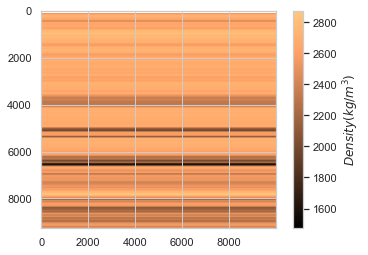

In [35]:
im_dens = plt.imshow(dens2d.T, cmap="copper")
cbar = plt.colorbar(im_dens)
cbar.set_label("$Density (kg/m^{3})$")
plt.show()

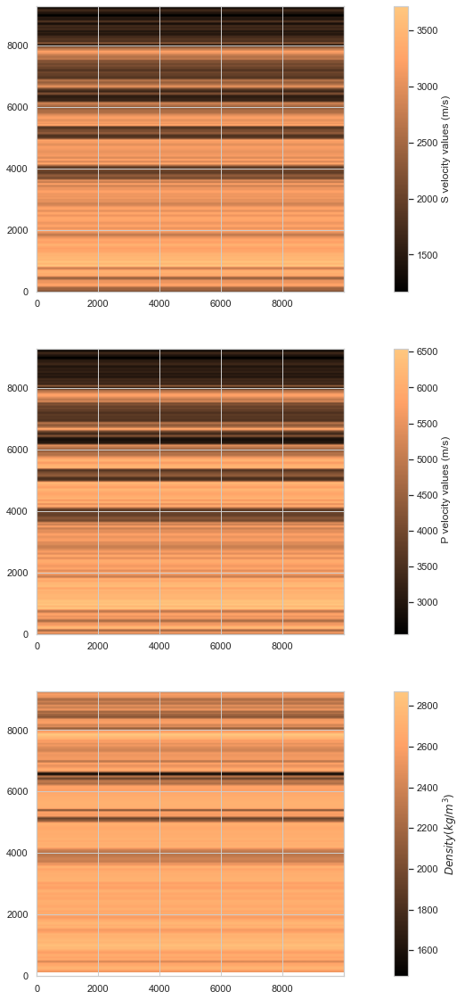

In [41]:
fig, axs = plt.subplots(3, 1, figsize=(20,20))  

# Primer gráfico vs
im3 = axs[0].imshow(vs2d.T, cmap="copper")
axs[0].invert_yaxis()
cbar = fig.colorbar(im3, ax=axs[0])  
cbar.set_label("S velocity values (m/s)")

# Segundo gráfico vp
im2 = axs[1].imshow(vp2d.T, cmap="copper")
axs[1].invert_yaxis()
cbar = fig.colorbar(im2, ax=axs[1])
cbar.set_label(" P velocity values (m/s)")

# tercer gráfico dens
im1 = axs[2].imshow(dens2d.T, cmap="copper")
axs[2].invert_yaxis()
cbar = fig.colorbar(im1, ax=axs[2])
cbar.set_label("$Density (kg/m^{3})$")

plt.show()

## depth 

In [44]:
num_pixels = vs2d.shape[0]
depth_tot = max(depth_m)

print(str(depth_tot)+' m is the maximum depth')

1614.678 m is the maximum depth
[[2110.01741048 2109.30045767 2109.26860853 ... 1400.65347285
  1397.5769149  1393.7621346 ]
 [2110.01741048 2109.30045767 2109.26860853 ... 1400.65347285
  1397.5769149  1393.7621346 ]
 [2110.01741048 2109.30045767 2109.26860853 ... 1400.65347285
  1397.5769149  1393.7621346 ]
 ...
 [2110.01741048 2109.30045767 2109.26860853 ... 1400.65347285
  1397.5769149  1393.7621346 ]
 [2110.01741048 2109.30045767 2109.26860853 ... 1400.65347285
  1397.5769149  1393.7621346 ]
 [2110.01741048 2109.30045767 2109.26860853 ... 1400.65347285
  1397.5769149  1393.7621346 ]]


In [27]:
depth_per_pixel = depth_tot / num_pixels
depth_per_pixel

0.16146780000000002

In [28]:
depths = np.arange(0, depth_tot, depth_per_pixel)
depths

array([0.00000000e+00, 1.61467800e-01, 3.22935600e-01, ...,
       1.61419360e+03, 1.61435506e+03, 1.61451653e+03])

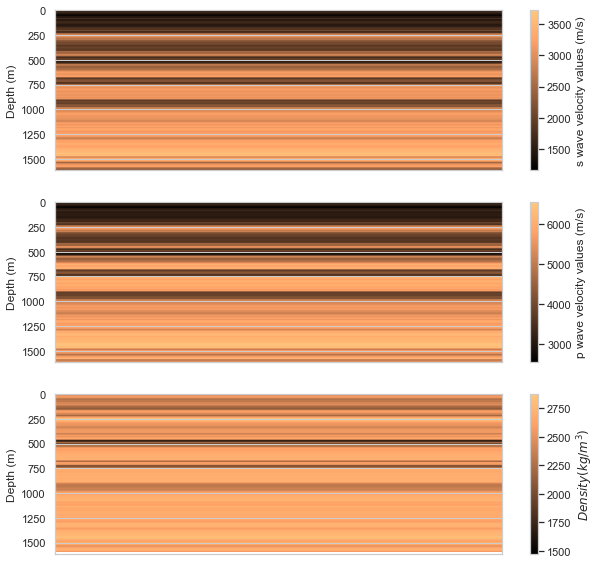

In [43]:
fig, axs = plt.subplots(3, 1, figsize=(10, 10))

# Primer gráfico: S velocity values
im3 = axs[0].imshow(vs2d.T, cmap="copper", extent=[0, vs2d.shape[1], 0, depth_tot], aspect='auto')
axs[0].invert_yaxis()  # Invertir el eje y para que la profundidad aumente hacia abajo
cbar = fig.colorbar(im3, ax=axs[0])
cbar.set_label("s wave velocity values (m/s)")
axs[0].set_xticks([])  # Ocultar marcas del eje x
axs[0].set_xlabel('')  # Ocultar etiqueta del eje x

# Segundo gráfico: P velocity values
im2 = axs[1].imshow(vp2d.T, cmap="copper", extent=[0, vp2d.shape[1], 0, depth_tot], aspect='auto')
axs[1].invert_yaxis()  # Invertir el eje y para que la profundidad aumente hacia abajo
cbar = fig.colorbar(im2, ax=axs[1])
cbar.set_label("p wave velocity values (m/s)")
axs[1].set_xticks([])  # Ocultar marcas del eje x
axs[1].set_xlabel('')  # Ocultar etiqueta del eje x

# tercer gráfico 250,3
im1 = axs[2].imshow(dens2d.T, cmap="copper", extent=[0, vp2d.shape[1], 0, depth_tot], aspect='auto')
axs[2].invert_yaxis()
cbar = fig.colorbar(im1, ax=axs[2])
cbar.set_label("$Density (kg/m^{3})$")
axs[2].set_xticks([])  # Ocultar marcas del eje x
axs[2].set_xlabel('')  # Ocultar etiqueta del eje x

# Etiquetas y título
axs[0].set_ylabel('Depth (m)')
axs[1].set_ylabel('Depth (m)')
axs[2].set_ylabel('Depth (m)')

plt.show()